# **Style transfer using GAN**
This notebook will be used to prepare the capstone project '[Style transfer using GAN](https://junyanz.github.io/CycleGAN/)'

## **Problem Statement**
Misdiagnosis in the medical field is a very serious issue but it’s also uncomfortably common to occur. Imaging procedures in the medical field requires an expert radiologist’s opinion since interpreting them is not a simple binary process ( Normal or Abnormal). Even so, one radiologist may see something that another does not. This can lead to conflicting reports and make it difficult to effectively recommend treatment options to the patient.

One of the complicated tasks in medical imaging is to diagnose MRI([Magnetic Resonance Imaging](https://en.wikipedia.org/wiki/Magnetic_resonance_imaging)). Sometimes to interpret the scan, the radiologist needs different variations of the imaging which can drastically enhance the accuracy of diagnosis by providing practitioners with a more comprehensive understanding.

 

 

But to have access to different imaging is difficult and expensive. With the help of deep learning, we can use style transfer to generate artificial MRI images of different contrast levels from existing MRI scans. This will help to provide a better diagnosis with the help of an additional image.

 

In this capstone, you will use [CycleGAN](https://machinelearningmastery.com/what-is-cyclegan/) [[tf ref.](https://www.tensorflow.org/tutorials/generative/cyclegan)] to translate the style of one MRI image to another, which will help in a better understanding of the scanned image. Using GANs you will create T2 weighted images from T1 weighted MRI image and vice-versa.

 

Problem statement: To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.


MRI T1_T2 Dataset
Download
NOTE: The T1 and T2 MRI Images included in the dataset are not related in any way since we have an unpaired dataset here.

 

**Project pipeline**

The project pipeline can be briefly summarized in the following three steps:

1. Data Understanding: Here, you need to load the data and create the dataset for it.
2. Image Processing: In this step, you will have to process the images using different steps.
3. Model-Building and Training: This is the final step at which you have to create your Generators and Discriminators using a modified U-Net architecture(similar to CycleGAN). You also have to define the loss function and training step for model training.

# **1. Importing Libraries**

In [1]:
#Import all the required libraries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage.transform import resize
import pathlib
import imageio
import glob
import PIL

2024-02-08 15:28:01.239271: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-08 15:28:01.239304: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-08 15:28:01.240177: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-08 15:28:01.247112: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-08 15:28:02.070935: W tensorflow/compiler/tf2

In [2]:
!nvidia-smi

Thu Feb  8 15:28:04 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.154.05             Driver Version: 535.154.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce GTX 1070 Ti     Off | 00000000:01:00.0  On |                  N/A |
| 28%   57C    P0              45W / 180W |    653MiB /  8192MiB |     12%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
#necessary step to add for, if you want to train the model on GPU
config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
session = tf.compat.v1.Session(config=config)

2024-02-08 15:28:04.297970: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-02-08 15:28:04.363274: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-02-08 15:28:04.363452: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

# **2. Data Preparation**
- Loading the data and storing it in tf.dataset
- Perfroming Train-Test split

In [4]:
data_dir_t1 = pathlib.Path("/home/zinger/Documents/upgrad/GAN-Style-Transfer/data/Tr1/TrainT1/")
data_dir_t2 = pathlib.Path("/home/zinger/Documents/upgrad/GAN-Style-Transfer/data/Tr2/TrainT2/")
print("T1 MRI images: ",len(list(data_dir_t1.glob('*.png'))))
print("T2 MRI images: ",len(list(data_dir_t2.glob('*.png'))))

T1 MRI images:  43
T2 MRI images:  46


In [5]:
# Initializing constants
BUFFER_SIZE = 1000
BATCH_SIZE = 16
EPOCHS = 100
img_height = 256
img_width = 256

Loading **TR1** images and splitting them into train-test split
- 40 train images
- 3 test images

In [6]:
# T1 MRI images Train set
tr1_train = tf.keras.preprocessing.image_dataset_from_directory(
                              data_dir_t1,
                              seed=123,
                              validation_split = 0.075,
                              subset = 'training',
                              labels=None,
                              image_size = (img_height, img_width),
                              batch_size=BATCH_SIZE)

Found 43 files belonging to 1 classes.
Using 40 files for training.


2024-02-08 15:28:04.497876: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-02-08 15:28:04.498179: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-02-08 15:28:04.498345: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [7]:
# TR1 Test set
tr1_test = tf.keras.preprocessing.image_dataset_from_directory(
                              data_dir_t1,
                              seed=123,
                              validation_split = 0.075,
                              subset = 'validation',
                              labels=None,
                              image_size=(img_height, img_width),
                              batch_size=1)

Found 43 files belonging to 1 classes.
Using 3 files for validation.


Loading **TR2** images and splitting them into train-test split
- 43 train images
- 3 test images

In [8]:
# TR2 Train set
tr2_train = tf.keras.preprocessing.image_dataset_from_directory(
                              data_dir_t2,
                              seed=123,
                              validation_split = 0.07,
                              subset = 'training',
                              labels=None,
                              image_size = (img_height, img_width),
                              batch_size=BATCH_SIZE)

Found 46 files belonging to 1 classes.
Using 43 files for training.


In [9]:
# TR2 Test set
tr2_test = tf.keras.preprocessing.image_dataset_from_directory(
                              data_dir_t2,
                              seed=123,
                              validation_split = 0.07,
                              subset = 'validation',
                              labels=None,
                              image_size=(img_height, img_width),
                              batch_size=1)

Found 46 files belonging to 1 classes.
Using 3 files for validation.


In [10]:
# https://www.tensorflow.org/guide/data_performance
# https://stackoverflow.com/questions/56613155/tensorflow-tf-data-autotune
# https://stackoverflow.com/questions/46444018/meaning-of-buffer-size-in-dataset-map-dataset-prefetch-and-dataset-shuffle
AUTOTUNE = tf.data.experimental.AUTOTUNE
tr1_train = tr1_train.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
tr1_test = tr1_test.cache().prefetch(buffer_size=AUTOTUNE)

tr2_train = tr2_train.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
tr2_test = tr2_test.cache().prefetch(buffer_size=AUTOTUNE)

# **3. Data Preprocessing** 
- Create a function to process your images with normalisation

- Apply the function to both the datasets 

- Visualise the MRI images after processing




Visualizing images prior preprocessing

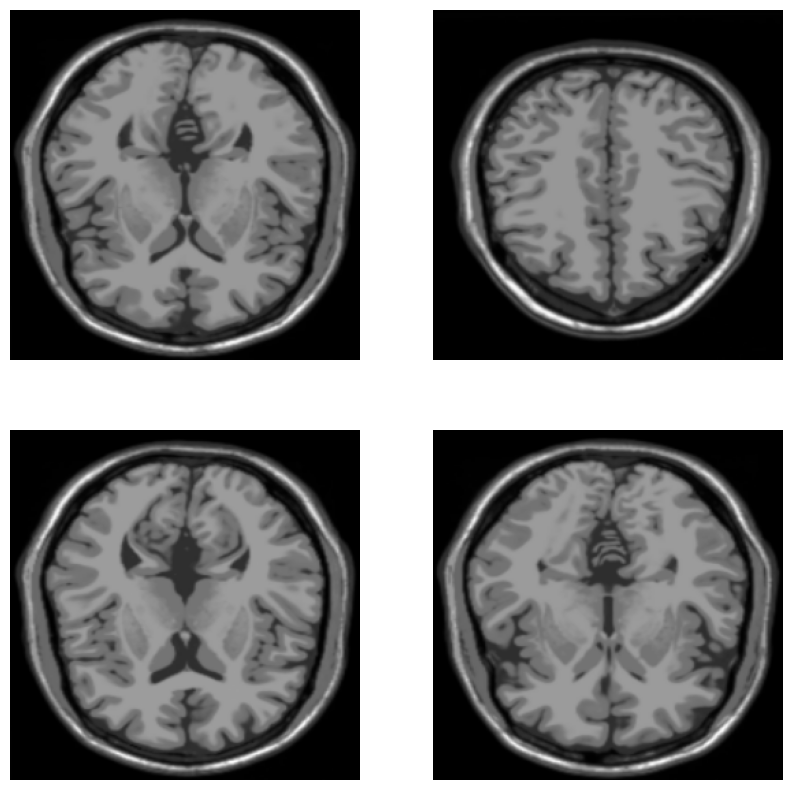

In [11]:
# Plotting T1 MRI Scans
plt.figure(figsize=(10, 10))
for images in tr1_train.take(1):
  for i in range(4):
    ax = plt.subplot(2, 2, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.axis("off")

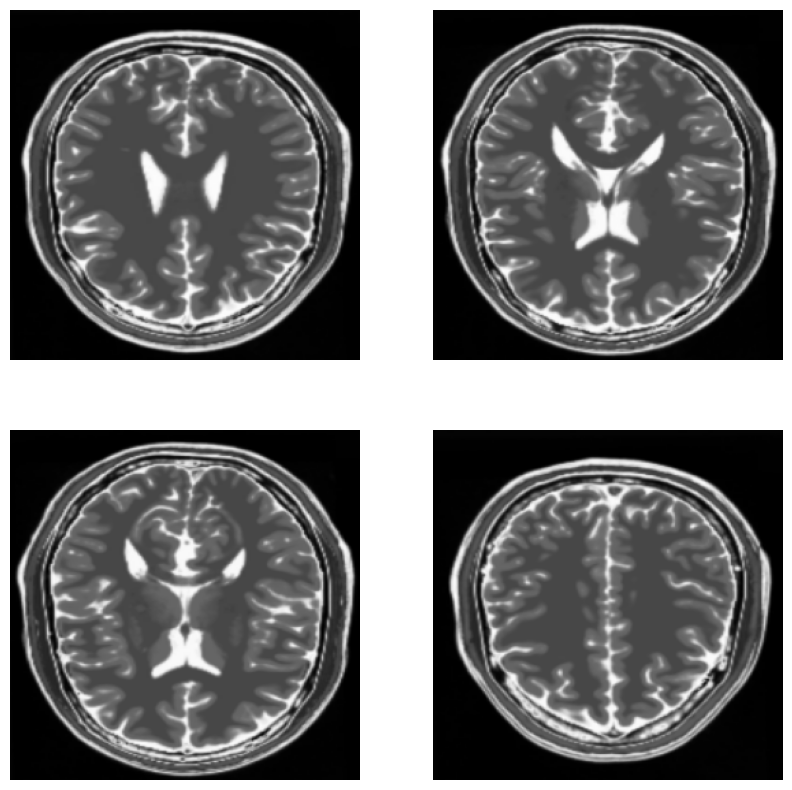

In [12]:
# Plotting T2 MRI Scans
plt.figure(figsize=(10, 10))
for images in tr2_train.take(1):
  for i in range(4):
    ax = plt.subplot(2, 2, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.axis("off")

## **3.1 Create a function to process your images with normalisation**


In [13]:
# normalizing the images to [-1, 1]
def normalize(image):
    image = (image/127.5)-1
    return image

# Alternate
# normalization_layer = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)

In [14]:
def preprocess_image_train(image):
    image = tf.image.random_flip_left_right(image)
    image = normalize(image)
    return image

## **3.2. Apply the function to both the datasets**

In [15]:
# process both classes of MRI images
tr1_train = tr1_train.map(lambda x: (preprocess_image_train(x)))
tr2_train = tr2_train.map(lambda x: (preprocess_image_train(x)))
tr1_test = tr1_test.map(lambda x: (preprocess_image_train(x)))
tr2_test = tr2_test.map(lambda x: (preprocess_image_train(x)))

Checking if images are noremalized between [-1 to 1]

In [16]:
image_batch_tr1 = next(iter(tr1_train))
image_batch_tr2 = next(iter(tr2_train))
tr1_1 = image_batch_tr1[0]
tr2_1 = image_batch_tr2[0]
# Notice the pixels values are now in `[-1,1]`.
print(np.min(tr1_1), np.max(tr1_1))
print(np.min(tr2_1), np.max(tr2_1))

-1.0 0.99244475
-1.0 0.98363185


## **3.3 Visualise the MRI images after processing**

In [17]:
sample_tr1 = next(iter(tr1_train))
sample_tr2 = next(iter(tr2_train))

In [18]:
sample_tr1.shape

TensorShape([8, 256, 256, 3])

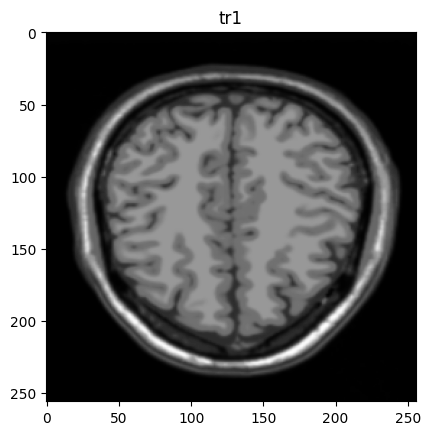

In [19]:
plt.title('tr1')
plt.imshow(sample_tr1[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

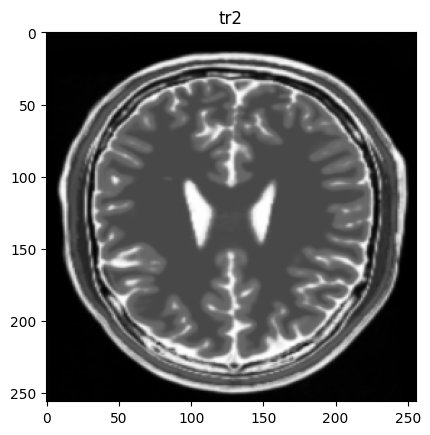

In [20]:
plt.title('tr2')
plt.imshow(sample_tr2[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

# **4. Model Building**

The architecture of generator is a modified U-Net.
- Instance Normalization

- Build Generator & Discriminator Architecture

- Define the loss functions

## **4.1 Instance Normalization**

In [21]:
class InstanceNormalization(tf.keras.layers.Layer):
    '''
    Instance vs Batch nom.: https://stackoverflow.com/questions/45463778/instance-normalisation-vs-batch-normalisation
    Normalization: https://www.tensorflow.org/addons/tutorials/layers_normalizations
    '''
    def __init__(self, epsilon=1e-5):
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    def call(self, x):
        # https://www.tensorflow.org/api_docs/python/tf/nn/moments
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

## **4.2. Building Generator & Discriminator architecture**

In [22]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    if apply_norm:
        result.add(InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    result.add(InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result

In [23]:
def unet_generator():
    down_stack = [
        downsample(64, 4, False), 
        downsample(128, 4), 
        downsample(128, 4), 
        downsample(128, 4), 
        downsample(128, 4) 
    ]
    up_stack = [
        upsample(128, 4, True), 
        upsample(128, 4, True),
        upsample(128, 4), 
        upsample(64, 4) 
    ]
        
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(3, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 256, 256, 3)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [24]:
generator_g = unet_generator() # Generates T2 images using T1 MRI Scans
generator_f = unet_generator() # Generates T1 images using T2 MRI Scans

In [25]:
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 128, 128, 64)         3072      ['input_1[0][0]']             
                                                                                                  
 sequential_1 (Sequential)   (None, 64, 64, 128)          131328    ['sequential[0][0]']          
                                                                                                  
 sequential_2 (Sequential)   (None, 32, 32, 128)          262400    ['sequential_1[0][0]']        
                                                                                              

In [26]:
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
    x = inp
    down1 = downsample(64, 4, False)(x) # (bs, 16, 16, 64)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 31, 31, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)
    return tf.keras.Model(inputs=inp, outputs=last)

In [27]:
discriminator_x = discriminator()
discriminator_y = discriminator()

In [28]:
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 256, 256, 3)]     0         
                                                                 
 sequential_18 (Sequential)  (None, 128, 128, 64)      3072      
                                                                 
 sequential_19 (Sequential)  (None, 64, 64, 128)       131328    
                                                                 
 sequential_20 (Sequential)  (None, 32, 32, 256)       524800    
                                                                 
 zero_padding2d (ZeroPaddin  (None, 34, 34, 256)       0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 31, 31, 512)       2097152   
                                                           

In [29]:
sample_tr1.shape

TensorShape([8, 256, 256, 3])

In [30]:
sample_tr2.shape

TensorShape([16, 256, 256, 3])

2024-02-08 15:28:08.294633: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-02-08 15:28:08.383286: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


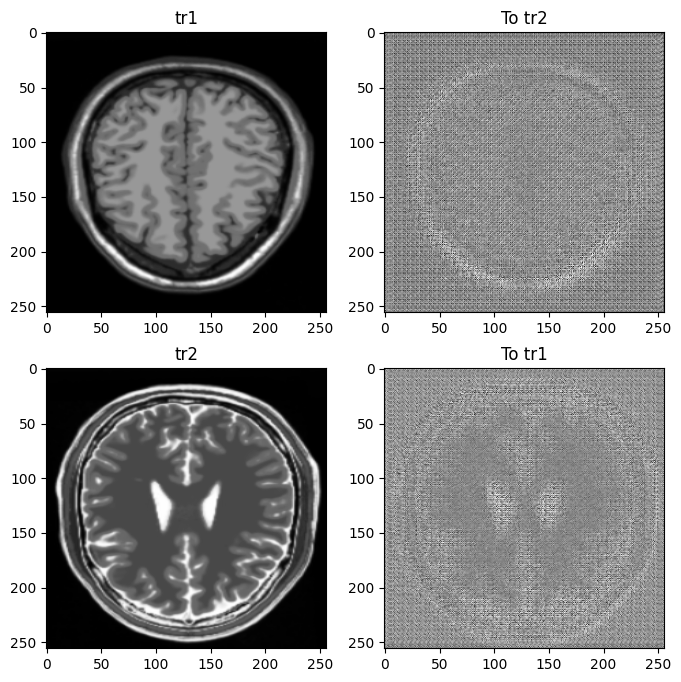

In [31]:
# Performing Predicton on untrained model
to_tr2 = generator_g(sample_tr1)
to_tr1 = generator_f(sample_tr2)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_tr1, to_tr2, sample_tr2, to_tr1]
title = ['tr1', 'To tr2', 'tr2', 'To tr1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
    else:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 * contrast + 0.5, cmap='gray')
plt.show()

## **4.3. Defining Loss Function**

In [32]:
LAMBDA = 10.0

In [33]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [34]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses

In [35]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

In [36]:
def calc_cycle_loss(real_image, cycled_image):
    '''
    Cycle consistency means that the recycled image should be closed to the original input 
    https://www.tensorflow.org/tutorials/generative/cyclegan
    '''
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return LAMBDA * loss1

In [37]:
def identity_loss(real_image, same_image):
    '''
    Identity loss says that, if you fed image  to generator , it should yield the real image  or something close to image .
    '''
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return LAMBDA * 0.5 * loss

In [38]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# **5 Model Training**

- Initializing Checkpoint manager
- Model training
- Performing predictions on test set

## **5.1. Initializing Checkpoint manager**

In [39]:
checkpoint_path = "/home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

# Ref: https://www.tensorflow.org/api_docs/python/tf/train/CheckpointManager
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print(f'Last Check Point: {ckpt_manager.latest_checkpoint}')
    print('Latest checkpoint restored!!')

Last Check Point: /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-82
Latest checkpoint restored!!


In [40]:
def generate_images(model1, test1, model2, test2):
    prediction1 = model1(test1)
    prediction2 = model2(test2)
    plt.figure(figsize=(10, 10))
    display_list = [test1[0], prediction1[0], test2[0], prediction2[0]]
    title = ['Input TR1 Image', 'Predicted TR2 Image', 'Input TR2 Image', 'Predicted TR1 Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
        plt.axis('off')
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

## **5.2. Training model for `100 EPOCHS`**

In [41]:
# Ref: https://www.tensorflow.org/guide/function
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X.
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)
        
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)
        
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = adversarial loss + cycle loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

Extract Inage from TF.Dataset: https://stackoverflow.com/questions/67521759/how-to-extract-data-without-label-from-tensorflow-dataset

In [42]:
for image_x, image_y in tf.data.Dataset.zip((tr1_train, tr2_train)):
  print(image_x.shape,image_y.shape)

(16, 256, 256, 3) (11, 256, 256, 3)
(16, 256, 256, 3) (16, 256, 256, 3)
(8, 256, 256, 3) (16, 256, 256, 3)


2024-02-08 15:28:22.078184: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/sequential_5/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2024-02-08 15:28:24.202716: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 4.28GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-02-08 15:28:24.442449: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 4.28GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-02-08 15:28:24.765956: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bf

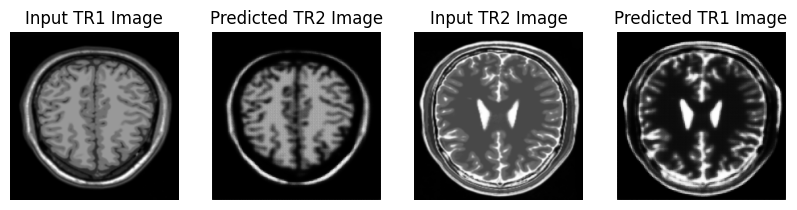

Saving checkpoint for epoch 1 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-83


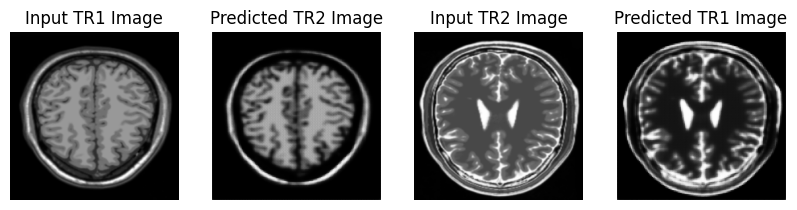

Saving checkpoint for epoch 2 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-84


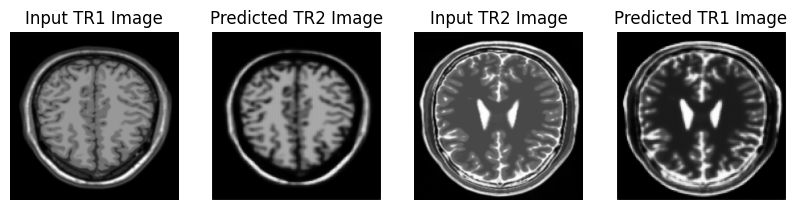

Saving checkpoint for epoch 3 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-85


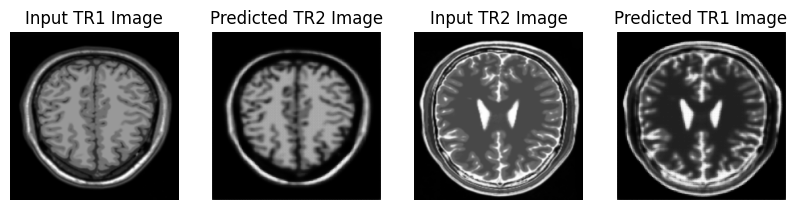

Saving checkpoint for epoch 4 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-86


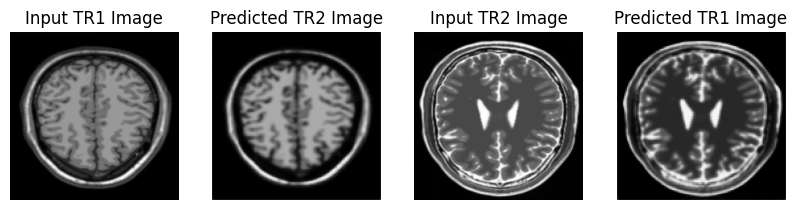

Saving checkpoint for epoch 5 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-87


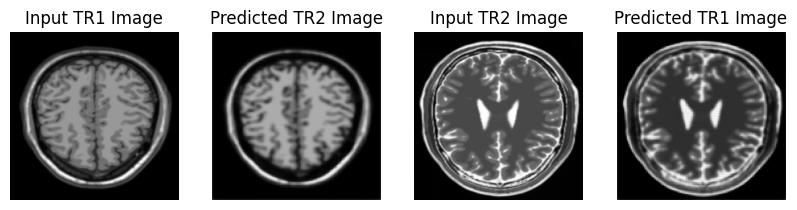

Saving checkpoint for epoch 6 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-88


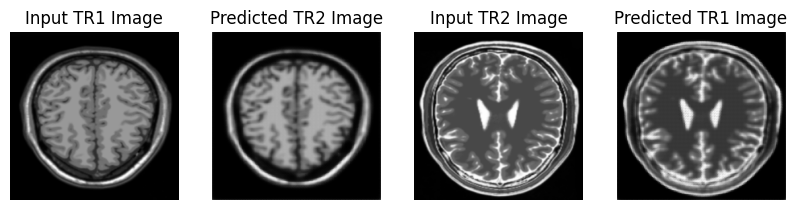

Saving checkpoint for epoch 7 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-89


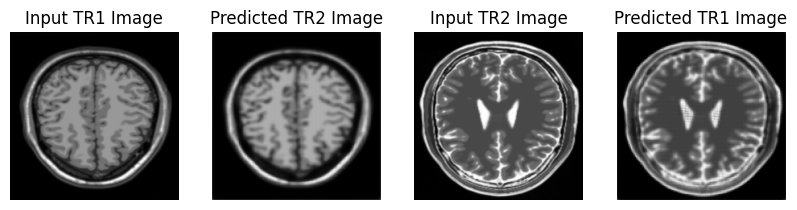

Saving checkpoint for epoch 8 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-90


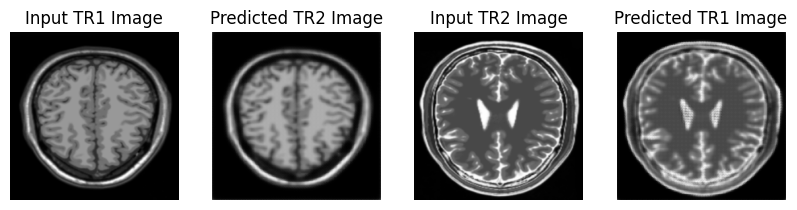

Saving checkpoint for epoch 9 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-91


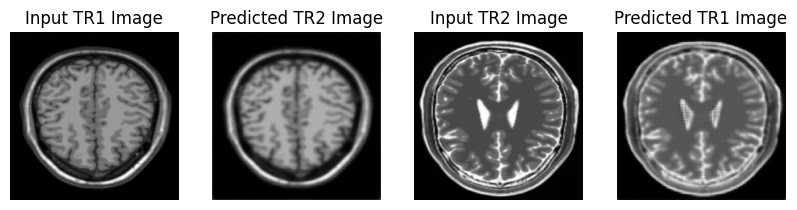

Saving checkpoint for epoch 10 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-92


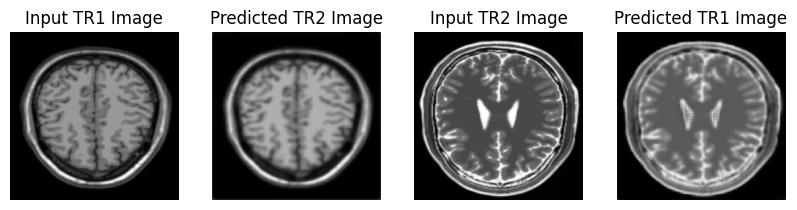

Saving checkpoint for epoch 11 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-93


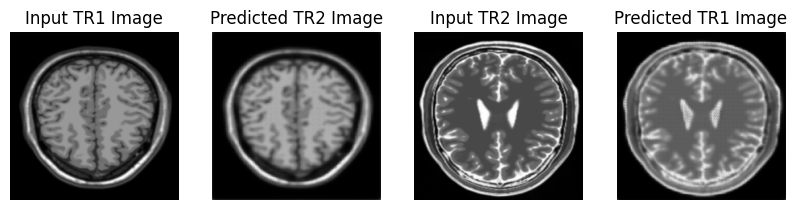

Saving checkpoint for epoch 12 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-94


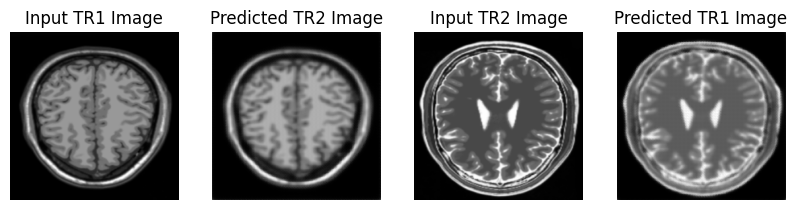

Saving checkpoint for epoch 13 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-95


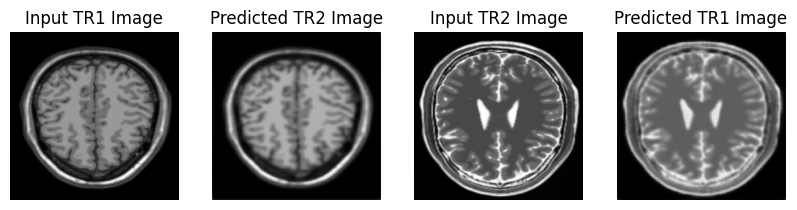

Saving checkpoint for epoch 14 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-96


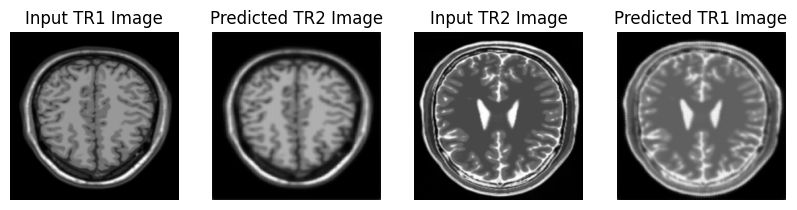

Saving checkpoint for epoch 15 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-97


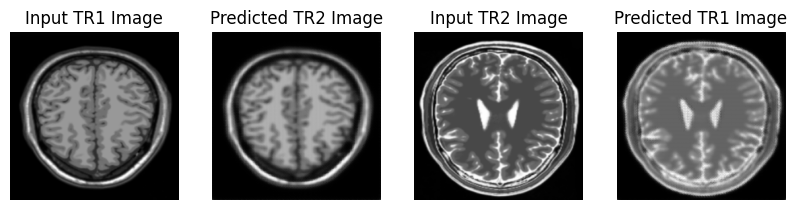

Saving checkpoint for epoch 16 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-98


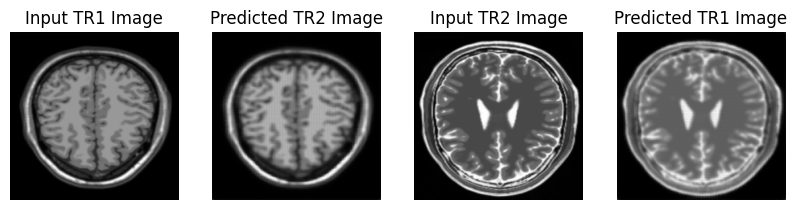

Saving checkpoint for epoch 17 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-99


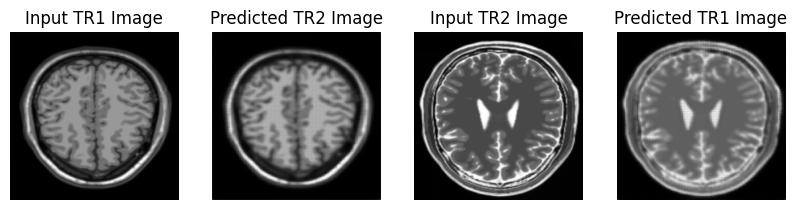

Saving checkpoint for epoch 18 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-100


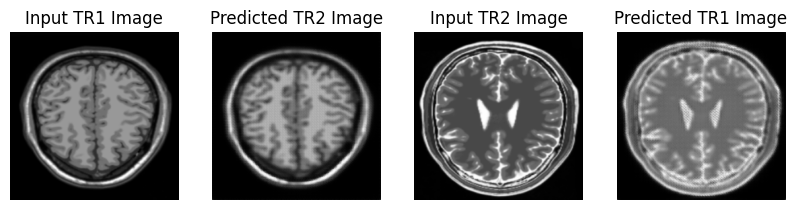

Saving checkpoint for epoch 19 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-101


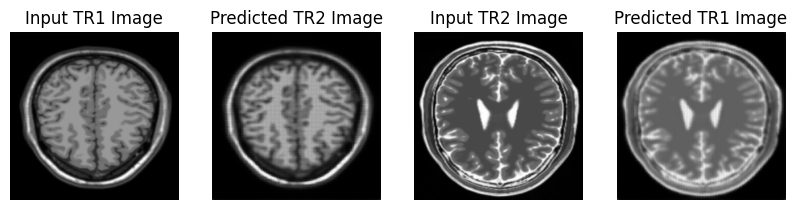

Saving checkpoint for epoch 20 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-102


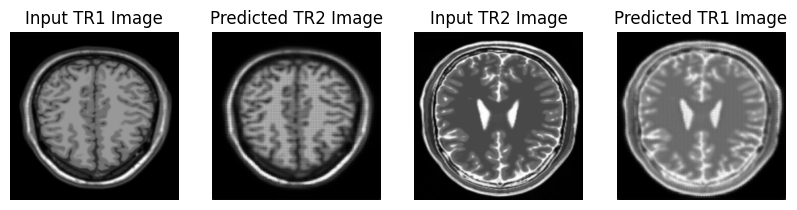

Saving checkpoint for epoch 21 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-103


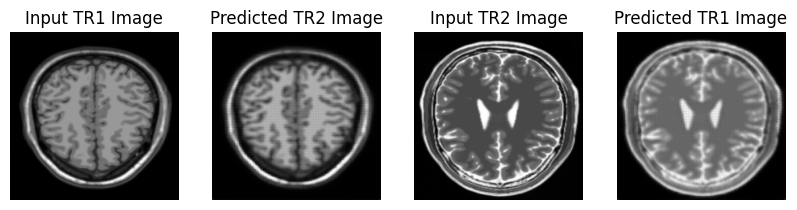

Saving checkpoint for epoch 22 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-104


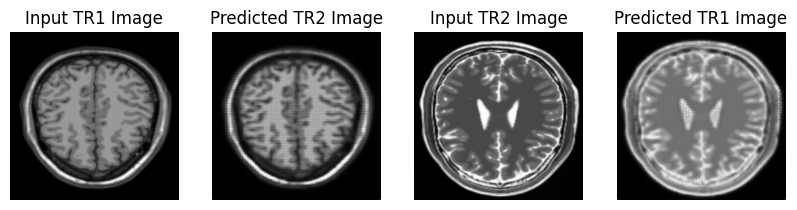

Saving checkpoint for epoch 23 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-105


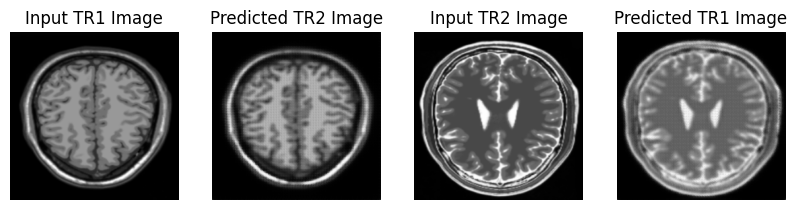

Saving checkpoint for epoch 24 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-106


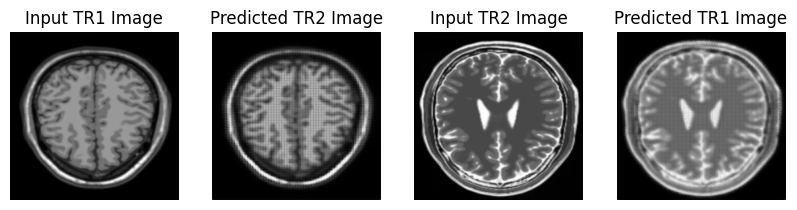

Saving checkpoint for epoch 25 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-107


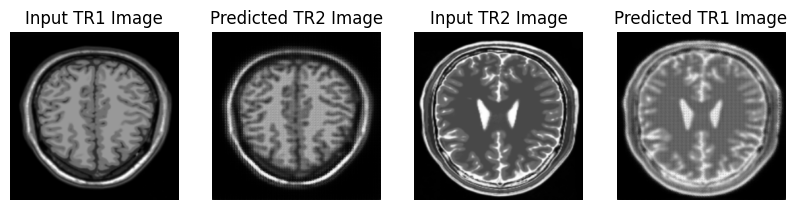

Saving checkpoint for epoch 26 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-108


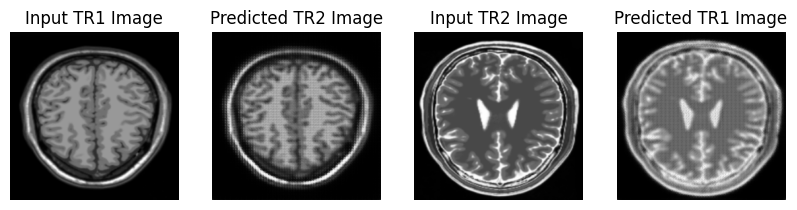

Saving checkpoint for epoch 27 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-109


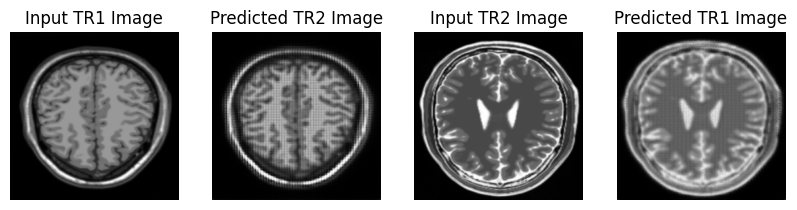

Saving checkpoint for epoch 28 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-110


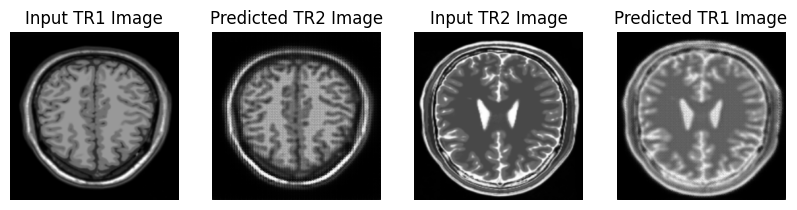

Saving checkpoint for epoch 29 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-111


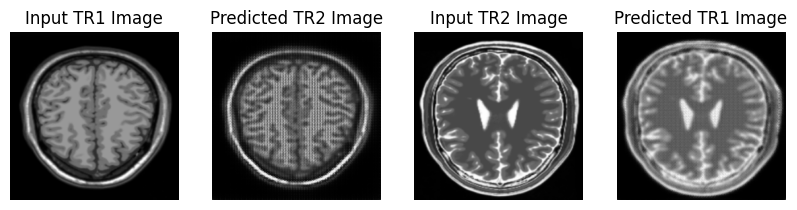

Saving checkpoint for epoch 30 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-112


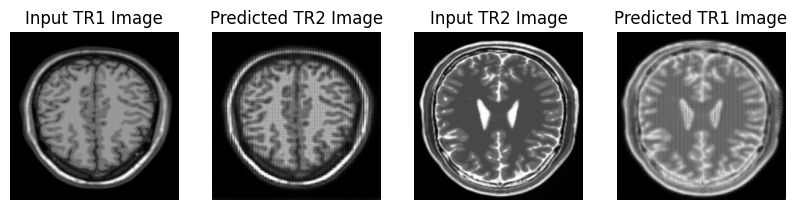

Saving checkpoint for epoch 31 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-113


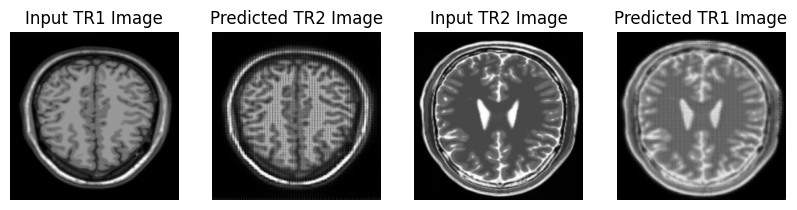

Saving checkpoint for epoch 32 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-114


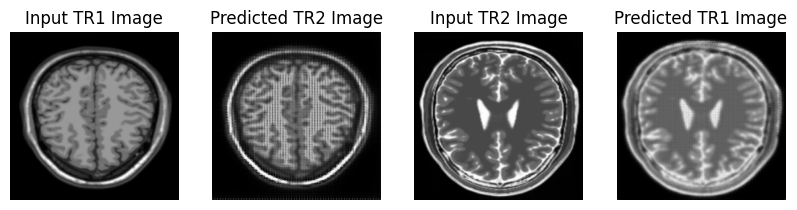

Saving checkpoint for epoch 33 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-115


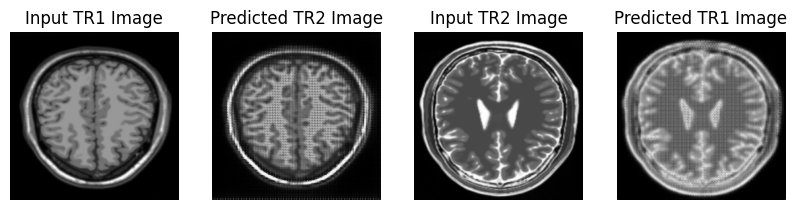

Saving checkpoint for epoch 34 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-116


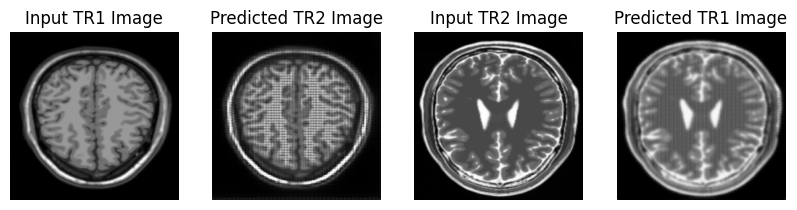

Saving checkpoint for epoch 35 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-117


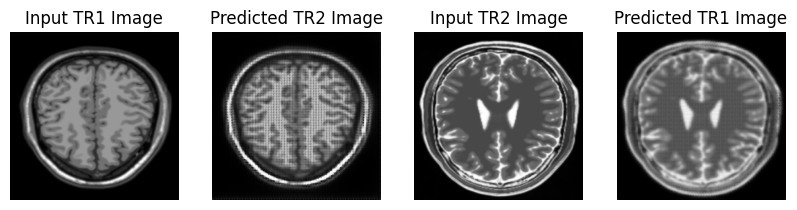

Saving checkpoint for epoch 36 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-118


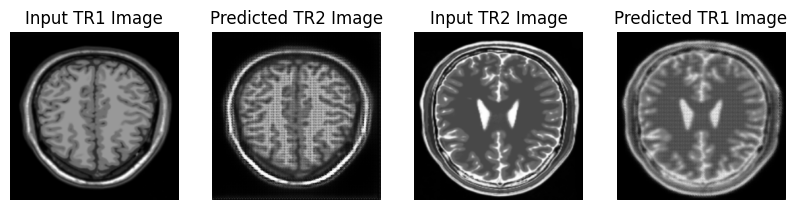

Saving checkpoint for epoch 37 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-119


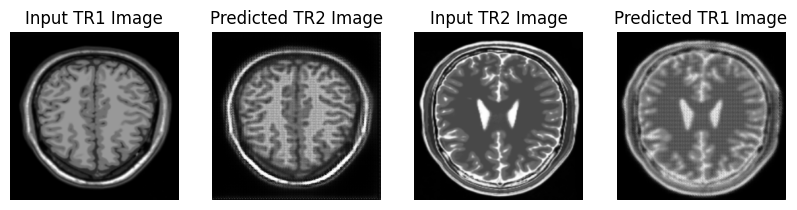

Saving checkpoint for epoch 38 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-120


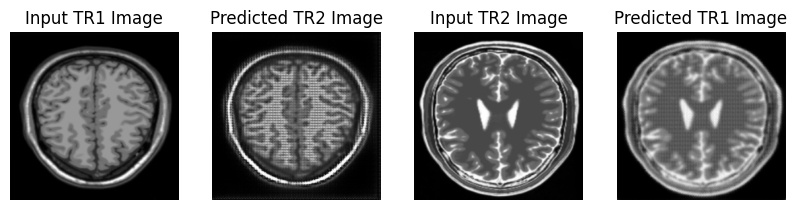

Saving checkpoint for epoch 39 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-121


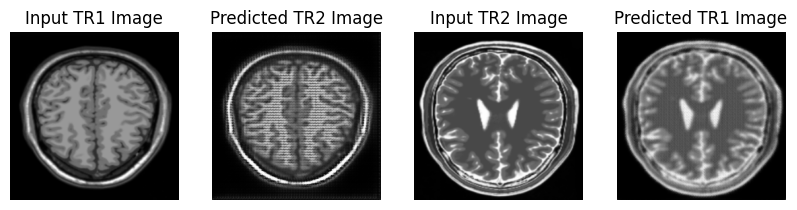

Saving checkpoint for epoch 40 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-122


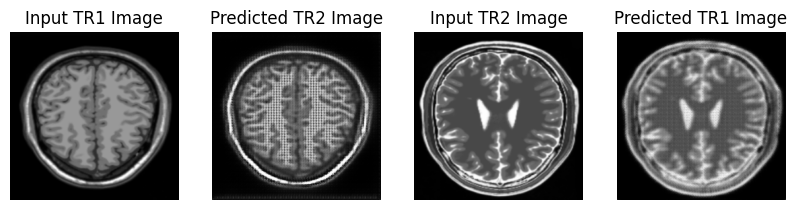

Saving checkpoint for epoch 41 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-123


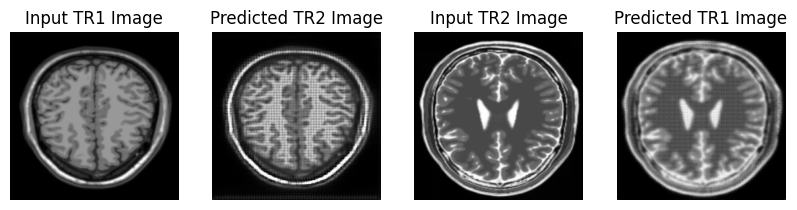

Saving checkpoint for epoch 42 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-124


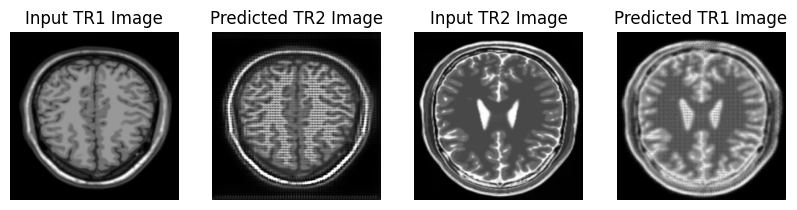

Saving checkpoint for epoch 43 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-125


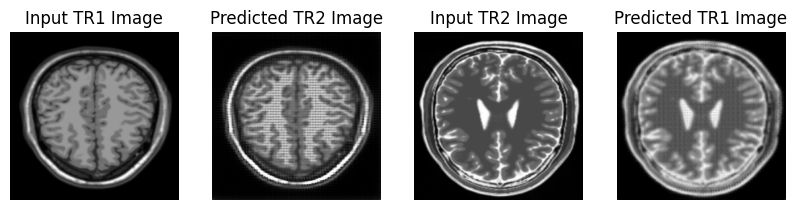

Saving checkpoint for epoch 44 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-126


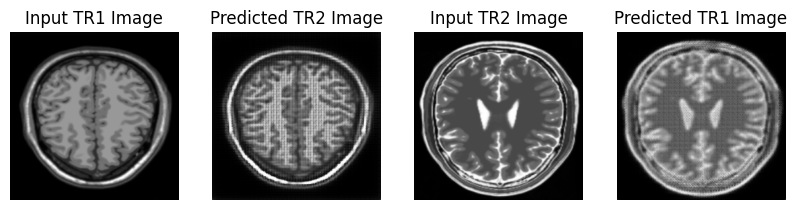

Saving checkpoint for epoch 45 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-127


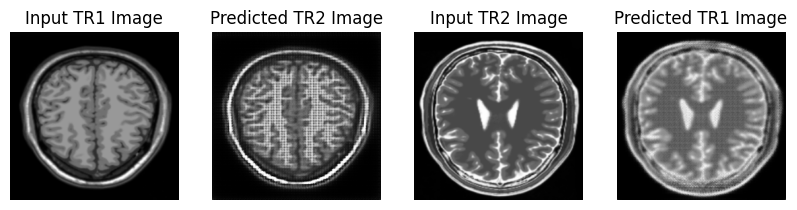

Saving checkpoint for epoch 46 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-128


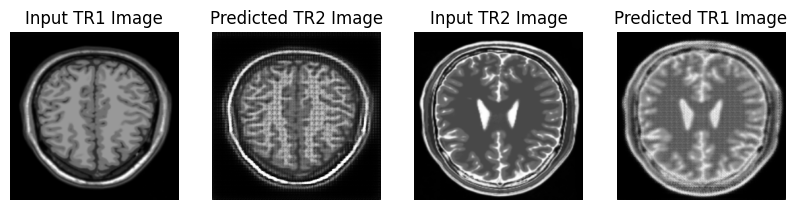

Saving checkpoint for epoch 47 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-129


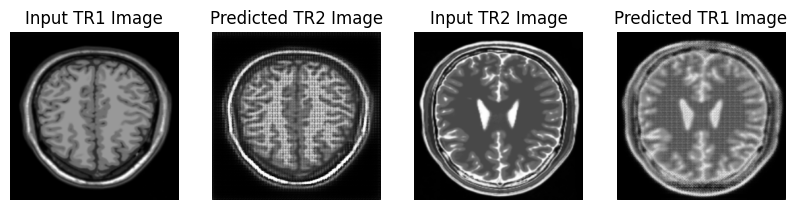

Saving checkpoint for epoch 48 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-130


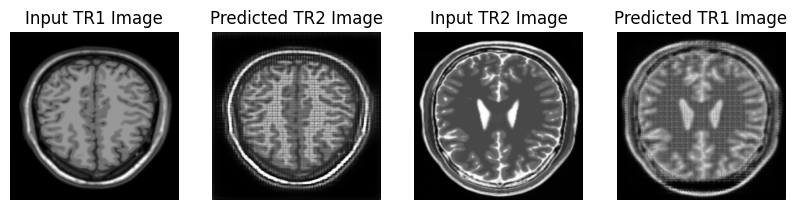

Saving checkpoint for epoch 49 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-131


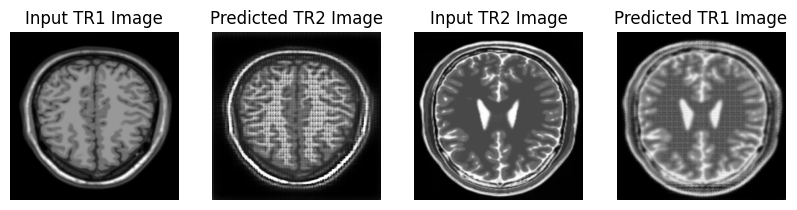

Saving checkpoint for epoch 50 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-132


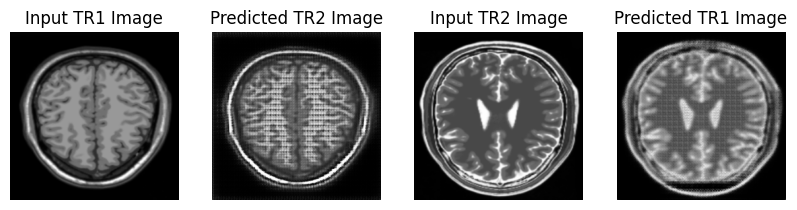

Saving checkpoint for epoch 51 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-133


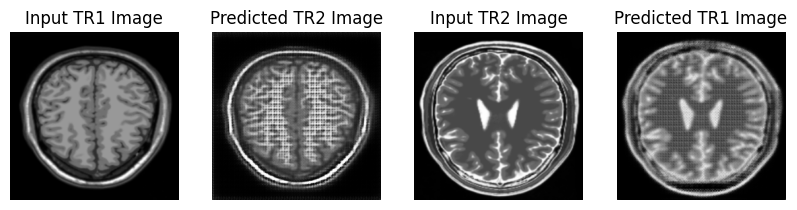

Saving checkpoint for epoch 52 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-134


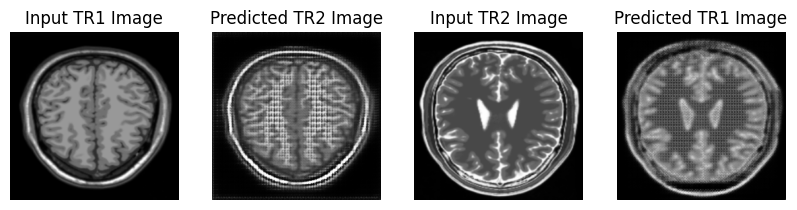

Saving checkpoint for epoch 53 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-135


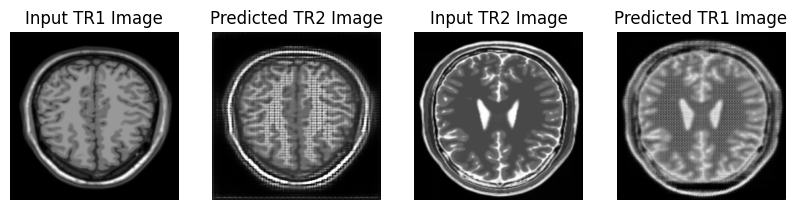

Saving checkpoint for epoch 54 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-136


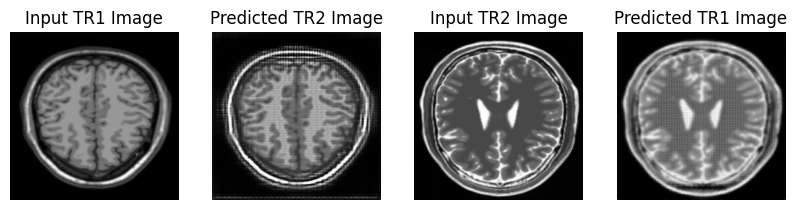

Saving checkpoint for epoch 55 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-137


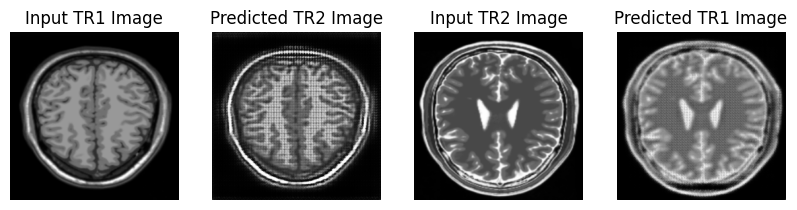

Saving checkpoint for epoch 56 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-138


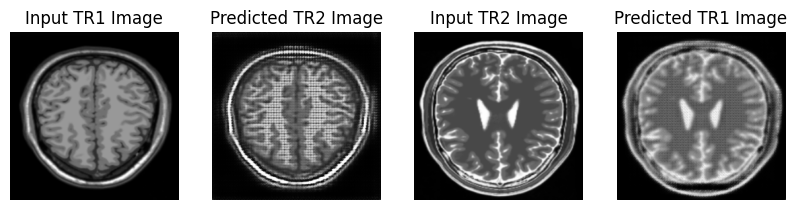

Saving checkpoint for epoch 57 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-139


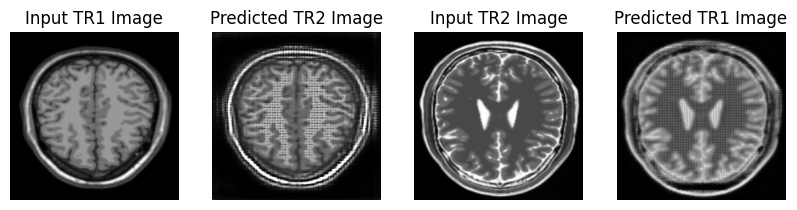

Saving checkpoint for epoch 58 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-140


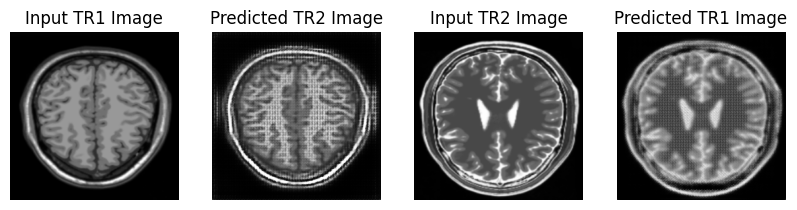

Saving checkpoint for epoch 59 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-141


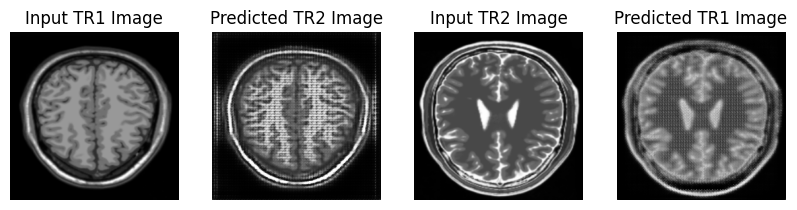

Saving checkpoint for epoch 60 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-142


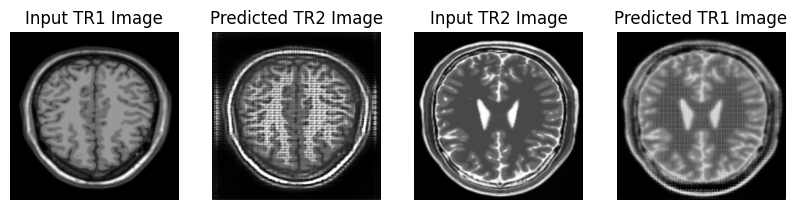

Saving checkpoint for epoch 61 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-143


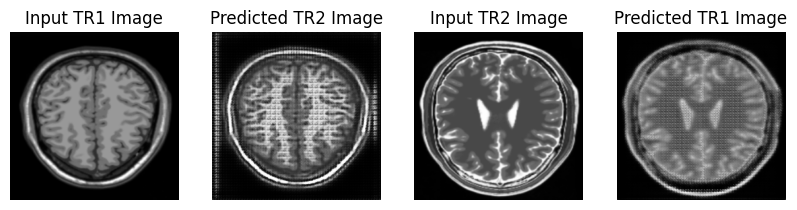

Saving checkpoint for epoch 62 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-144


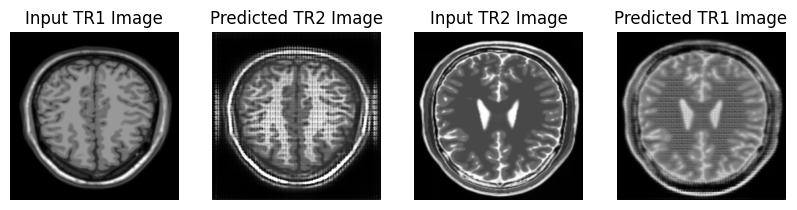

Saving checkpoint for epoch 63 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-145


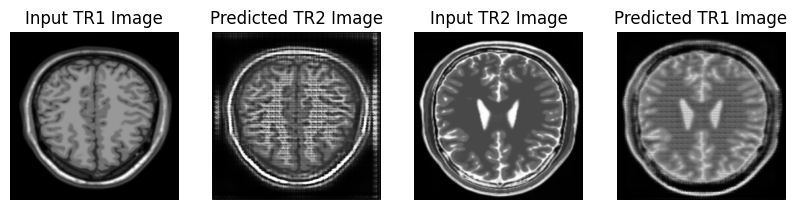

Saving checkpoint for epoch 64 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-146


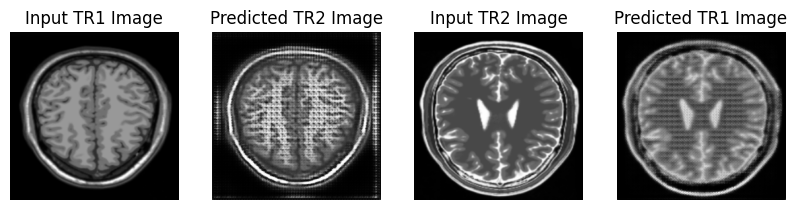

Saving checkpoint for epoch 65 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-147


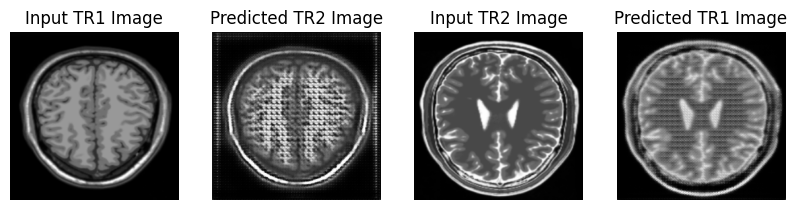

Saving checkpoint for epoch 66 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-148


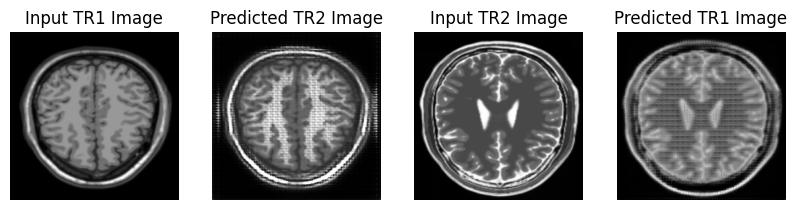

Saving checkpoint for epoch 67 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-149


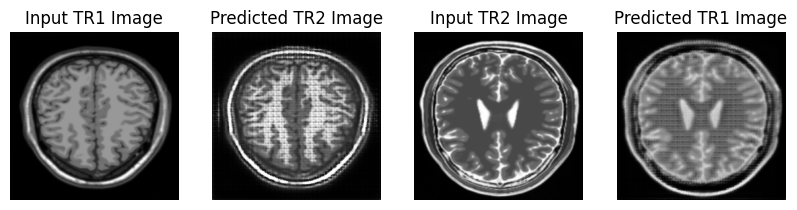

Saving checkpoint for epoch 68 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-150


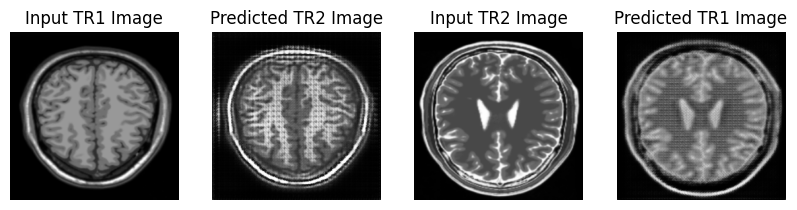

Saving checkpoint for epoch 69 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-151


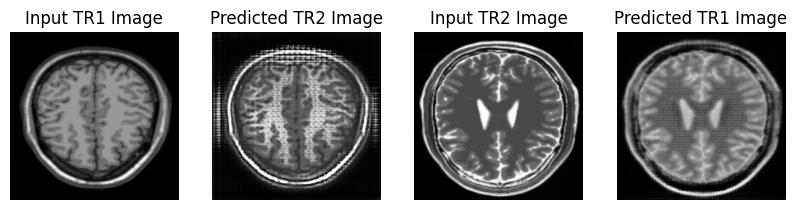

Saving checkpoint for epoch 70 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-152


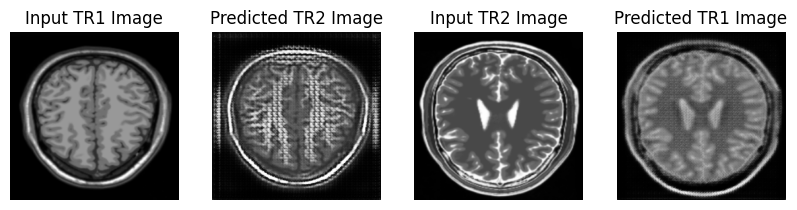

Saving checkpoint for epoch 71 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-153


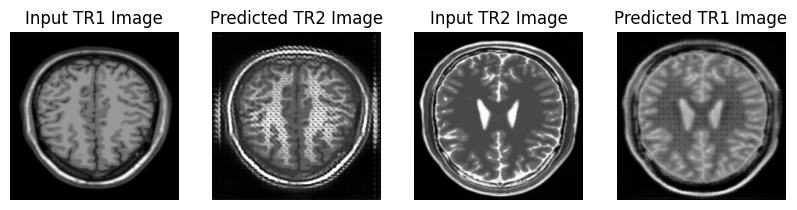

Saving checkpoint for epoch 72 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-154


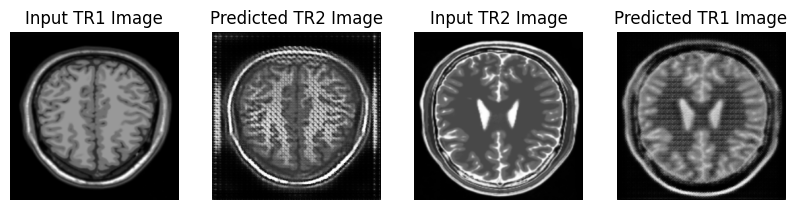

Saving checkpoint for epoch 73 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-155


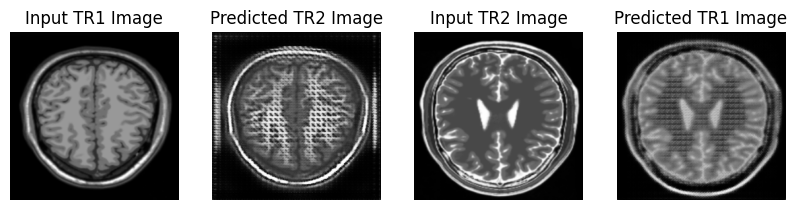

Saving checkpoint for epoch 74 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-156


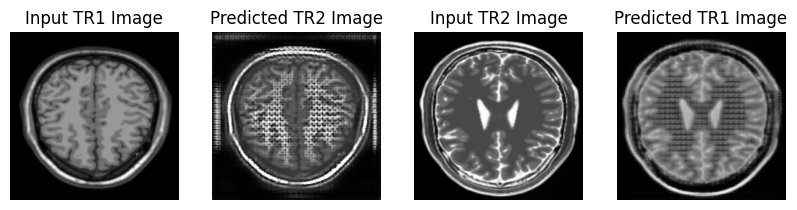

Saving checkpoint for epoch 75 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-157


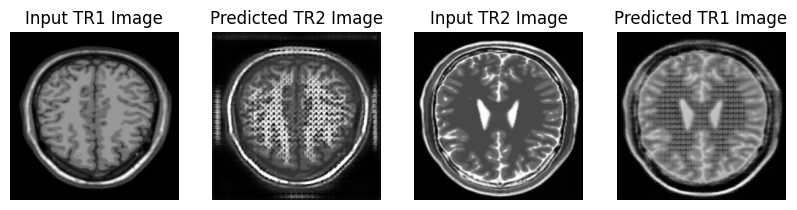

Saving checkpoint for epoch 76 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-158


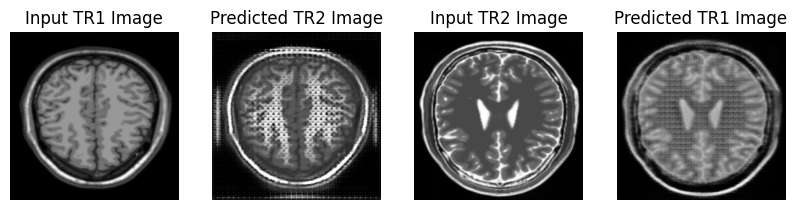

Saving checkpoint for epoch 77 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-159


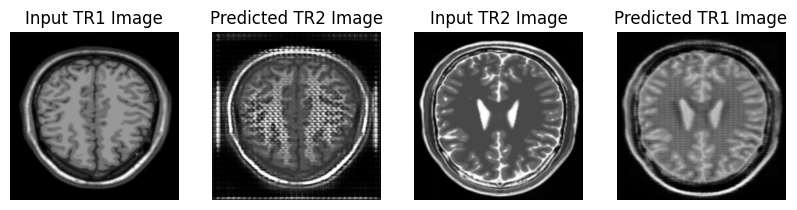

Saving checkpoint for epoch 78 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-160


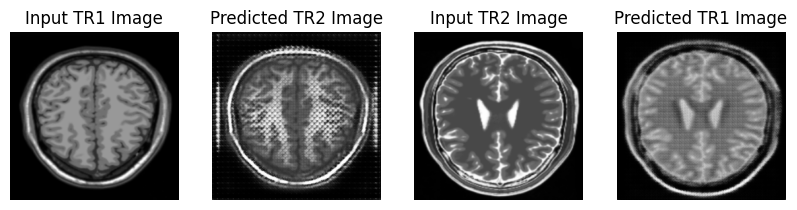

Saving checkpoint for epoch 79 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-161


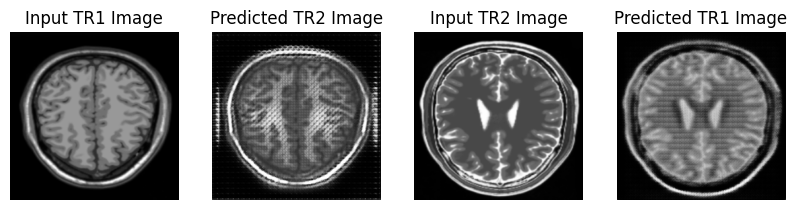

Saving checkpoint for epoch 80 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-162


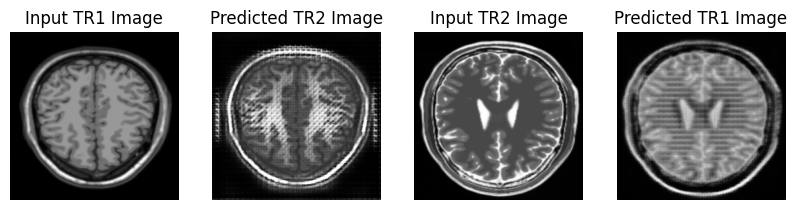

Saving checkpoint for epoch 81 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-163


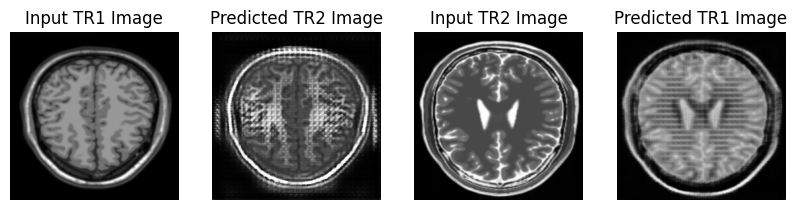

Saving checkpoint for epoch 82 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-164


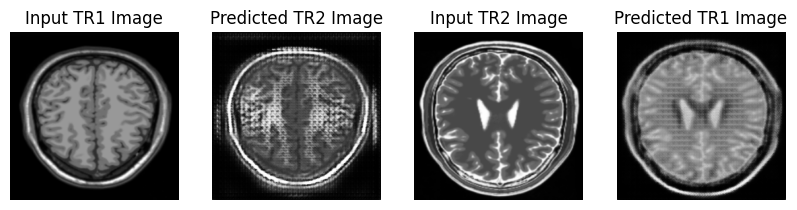

Saving checkpoint for epoch 83 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-165


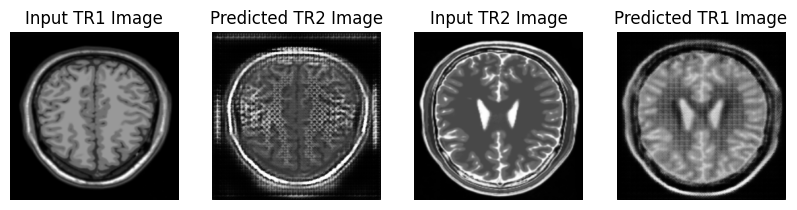

Saving checkpoint for epoch 84 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-166


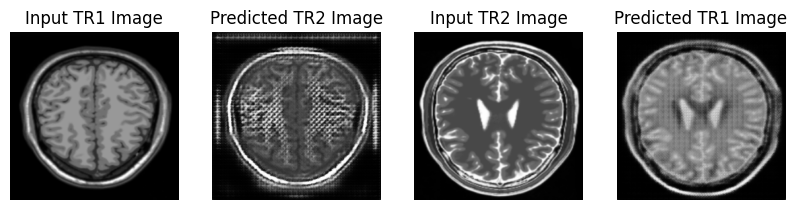

Saving checkpoint for epoch 85 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-167


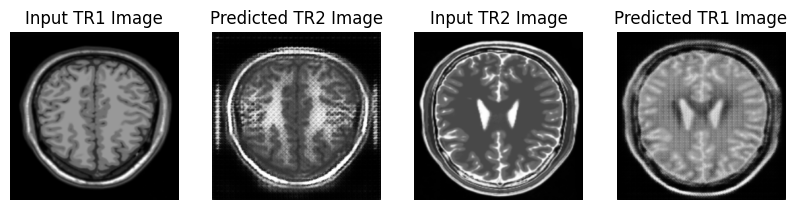

Saving checkpoint for epoch 86 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-168


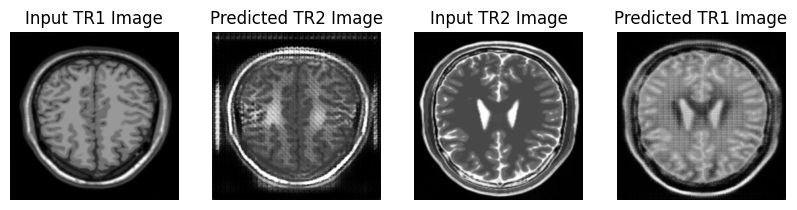

Saving checkpoint for epoch 87 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-169


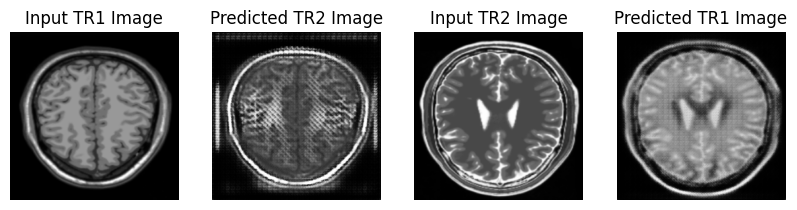

Saving checkpoint for epoch 88 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-170


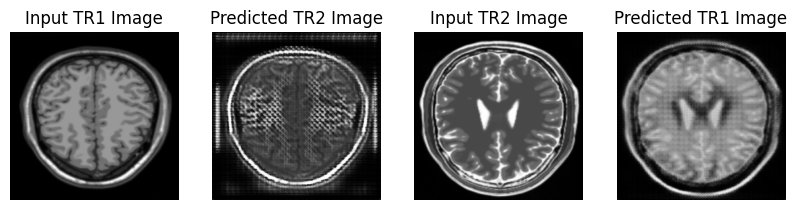

Saving checkpoint for epoch 89 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-171


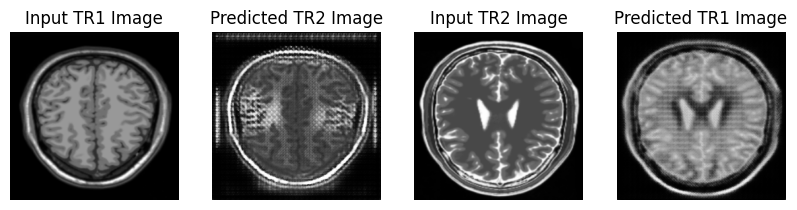

Saving checkpoint for epoch 90 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-172


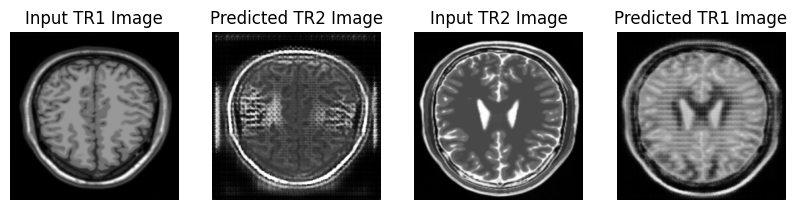

Saving checkpoint for epoch 91 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-173


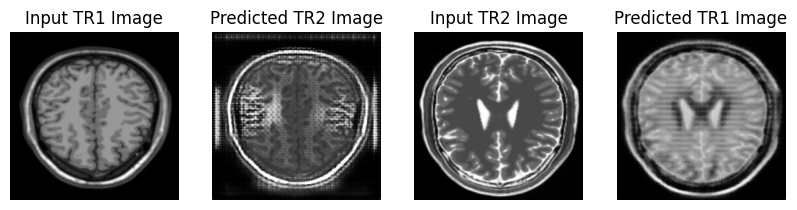

Saving checkpoint for epoch 92 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-174


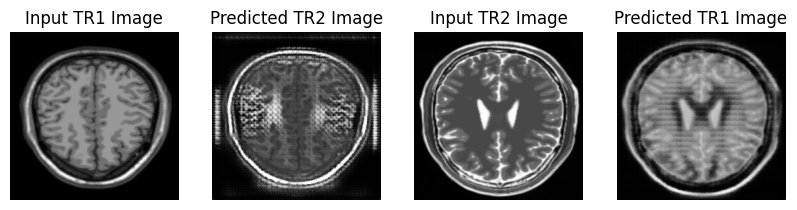

Saving checkpoint for epoch 93 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-175


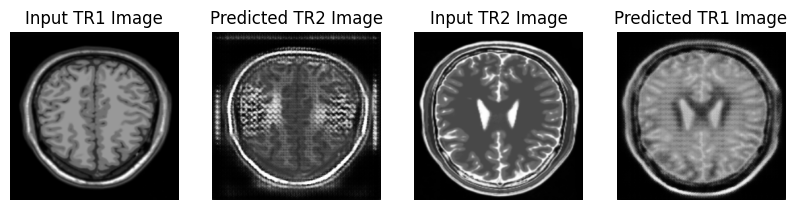

Saving checkpoint for epoch 94 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-176


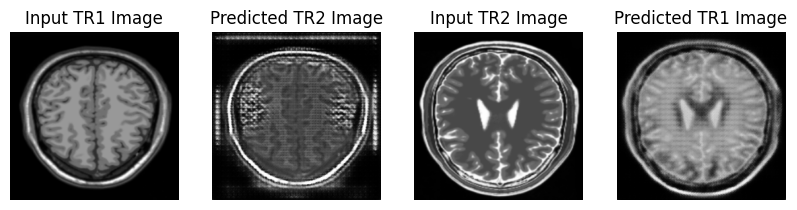

Saving checkpoint for epoch 95 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-177


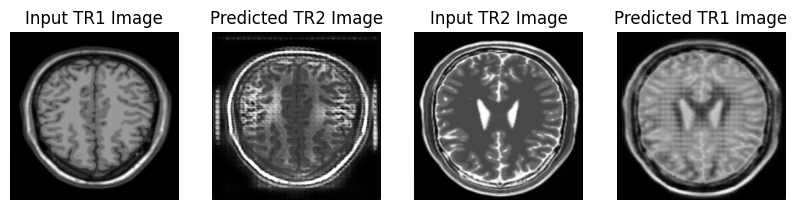

Saving checkpoint for epoch 96 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-178


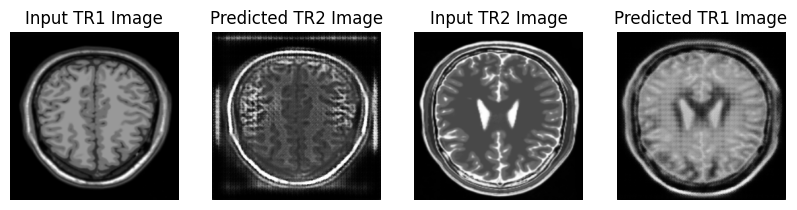

Saving checkpoint for epoch 97 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-179


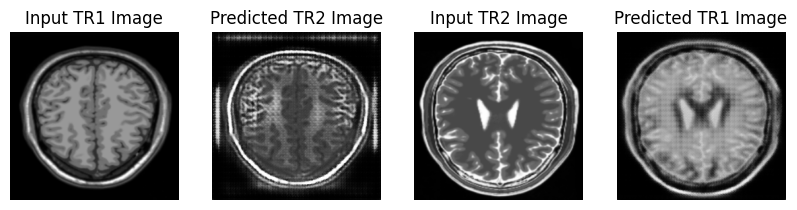

Saving checkpoint for epoch 98 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-180


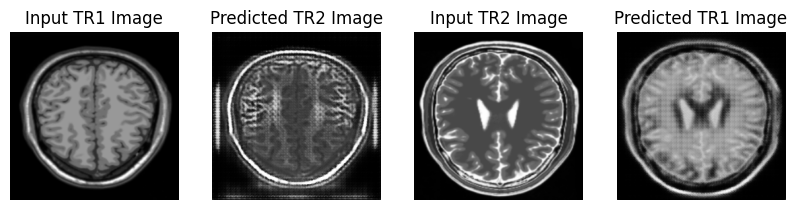

Saving checkpoint for epoch 99 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-181


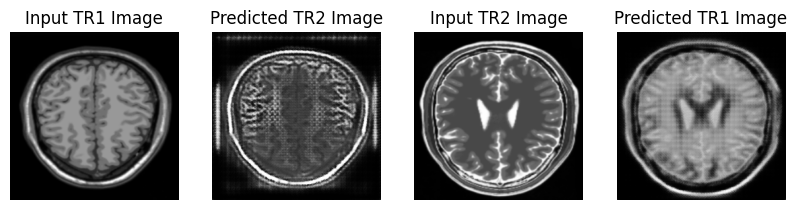

Saving checkpoint for epoch 100 at /home/zinger/Documents/upgrad/GAN-Style-Transfer/trained_model/ckpt-182


In [43]:
for epoch in range(1,EPOCHS+1):
    for image_x, image_y in tf.data.Dataset.zip((tr1_train, tr2_train)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_tr1, generator_f, sample_tr2)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

## **5.3. Performing prediction on test data**

In [44]:
for image_x, image_y in tf.data.Dataset.zip((tr1_test, tr2_test)):
  print(image_x.shape,image_y.shape)

(1, 256, 256, 3) (1, 256, 256, 3)
(1, 256, 256, 3) (1, 256, 256, 3)
(1, 256, 256, 3) (1, 256, 256, 3)


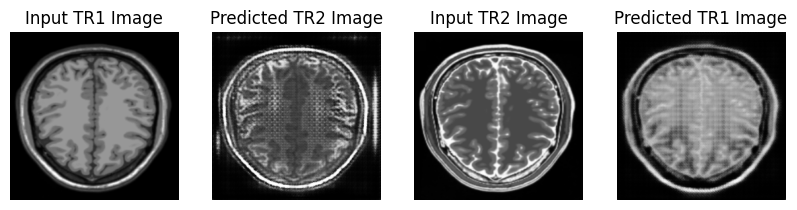

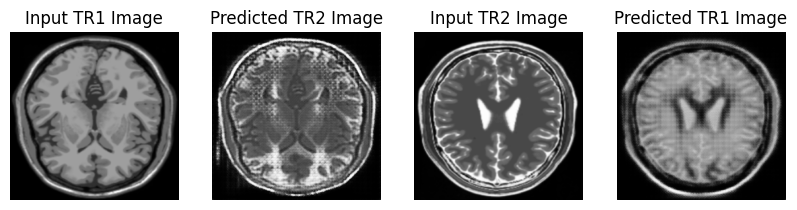

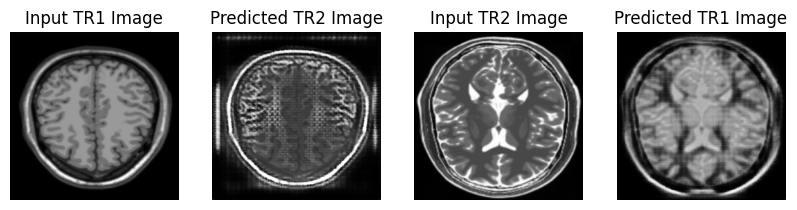

In [45]:
for image_x, image_y in tf.data.Dataset.zip((tr1_test, tr2_test)):
  generate_images(generator_g, image_x, generator_f, image_y)

# **6. Generating GIF**

In [46]:
anim_file = 'cyclegan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipykernel_3049058/3274524612.py:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipykernel_3049058/3274524612.py:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



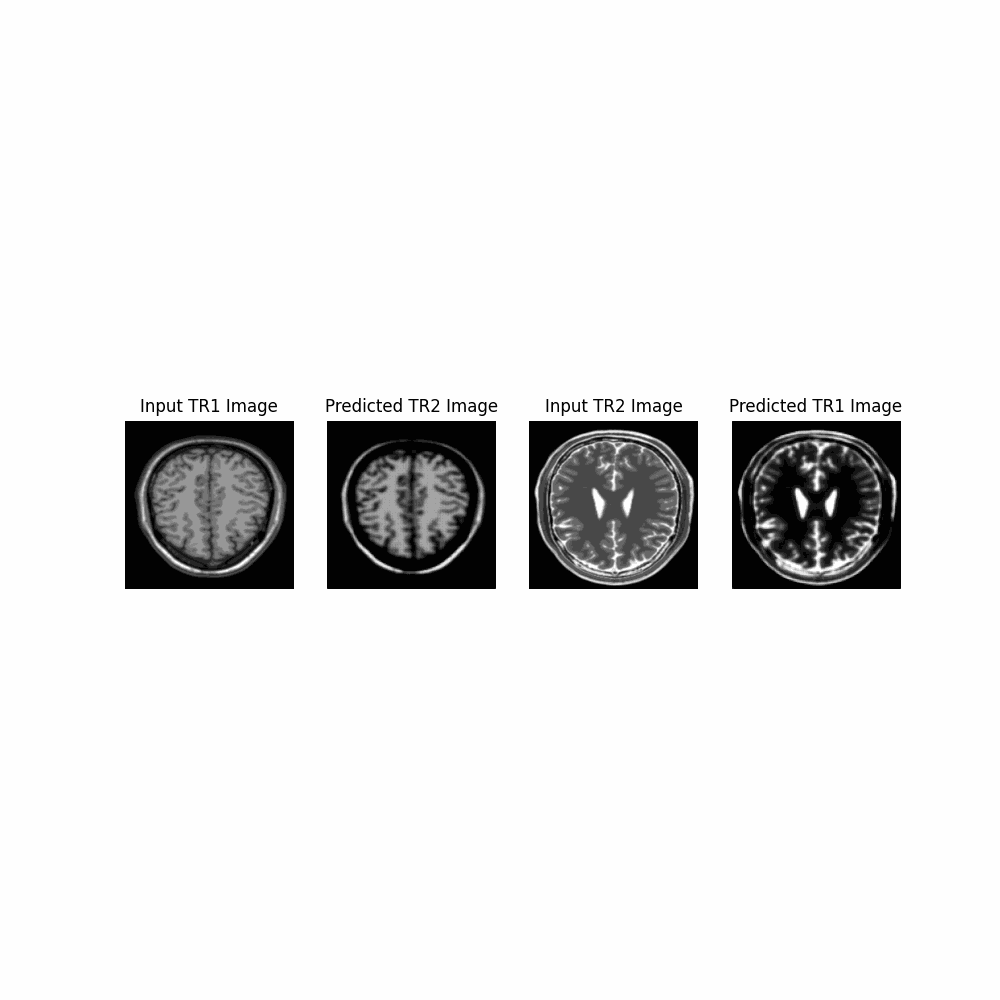

In [47]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)